# 🚦 Analisis Big Data Geospatial - Aksesibilitas Kesehatan dan Transportasi Kota Administrasi Jakarta Selatan menggunakan OpenStreetMap dan OSMNX

**Nama  : Reizka Fathia**

**NPM   : 2206052755**

**Prodi : S1 Matematika**

**Kelas : ADTT - A**

Proyek mini untuk analisis spasial jaringan jalan dan aksesibilitas kesehatan di Kota Administrasi Jakarta Selatan.

## Tujuan:
- Mengambil jaringan jalan dari Open Street Map (OSM)
- Analisis statistik jaringan
- Analisis centrality
- Analisis aksesibilitas ke rumah sakit
- Visualisasi jaringan dan Point-of-Interest (POI)


In [ ]:
# 🔧 Install dependencies
!pip install osmnx --upgrade folium geopandas networkx --quiet

In [ ]:
# 📚 Import libraries
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt
import folium
import geopandas as gpd
import pandas as pd
import numpy as np

In [ ]:
# 🌍 Ambil jaringan jalan Kota Administrasi Jakarta Selatan
place = "Jakarta Selatan, Indonesia"
G = ox.graph_from_place(place, network_type="drive")
nodes, edges = ox.graph_to_gdfs(G)

In [ ]:
# 📊 Statistik jaringan
stats = ox.basic_stats(G)
pd.Series(stats).head(10)

,0
n,24277
m,53632
k_avg,4.418338
edge_length_total,3655391.778362
edge_length_avg,68.156917
streets_per_node_avg,2.433909
streets_per_node_counts,"{0: 0, 1: 7612, 2: 50, 3: 15098, 4: 1505, 5: 1..."
streets_per_node_proportions,"{0: 0.0, 1: 0.3135478024467603, 2: 0.002059562..."
intersection_count,16665
street_length_total,2095701.94413


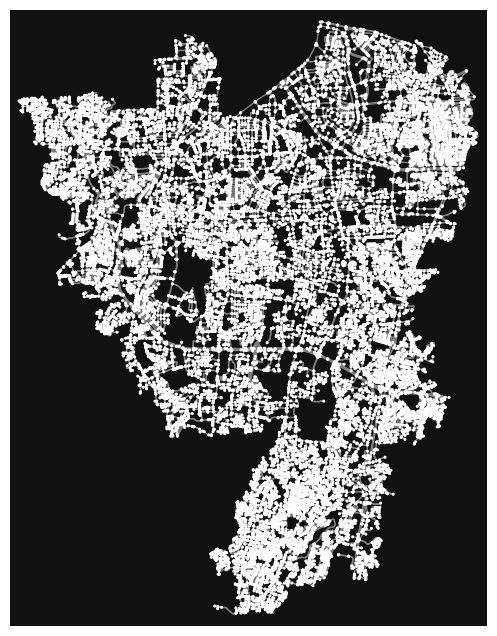

In [ ]:
# 🗺️ Visualisasi jaringan
fig, ax = ox.plot_graph(G, node_size=5, edge_color="gray")

In [ ]:
# 📍 Analisis centrality
degree = nx.degree_centrality(G)
nx.set_node_attributes(G, degree, "degree")
top_nodes = sorted(degree.items(), key=lambda x: x[1], reverse=True)[:5]
top_nodes

[(3895574363, 0.0004119294776734223),
 (5114866633, 0.0004119294776734223),
 (6660405579, 0.0004119294776734223),
 (186858141, 0.00032954358213873783),
 (186908081, 0.00032954358213873783)]

In [ ]:
# 🏥 Ambil data rumah sakit dari OSM
tags = {'amenity': 'hospital'}
hospitals = ox.features_from_place(place, tags=tags)
hospital_points = hospitals.centroid.to_frame(name='geometry').reset_index()
hospital_points = gpd.GeoDataFrame(hospital_points, geometry='geometry', crs=hospitals.crs)
hospital_points.head()

<ipython-input-64-f8a87a774f29>:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  hospital_points = hospitals.centroid.to_frame(name='geometry').reset_index()


,element,id,geometry
0,node,5751013085,POINT (106.83356 -6.2855)
1,node,5903905786,POINT (106.81737 -6.33654)
2,node,10758124598,POINT (106.85546 -6.22829)
3,node,11285959508,POINT (106.7879 -6.24069)
4,node,11878722413,POINT (106.81996 -6.29414)


<Axes: title={'center': 'Distribusi Jarak dari RS ke Semua Titik'}, ylabel='Frequency'>

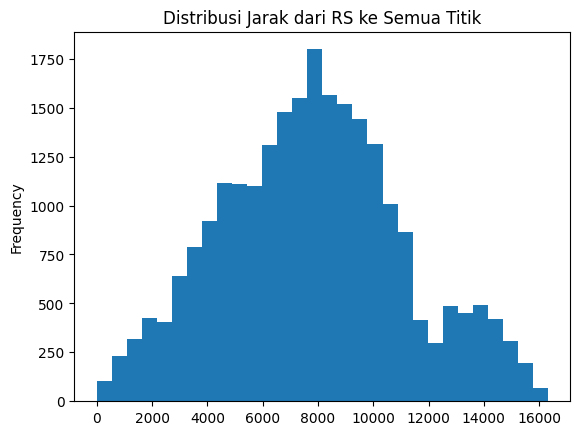

In [ ]:
# 📐 Analisis jarak dari rumah sakit ke node terdekat
hospital_points['nearest_node'] = hospital_points['geometry'].apply(
    lambda point: ox.distance.nearest_nodes(G, point.x, point.y))

source_node = hospital_points['nearest_node'].iloc[0]
lengths = nx.single_source_dijkstra_path_length(G, source_node, weight='length')

pd.Series(lengths).plot(kind='hist', bins=30, title='Distribusi Jarak dari RS ke Semua Titik')

In [ ]:
# 🗺️ Peta interaktif jaringan dan rumah sakit
m = folium.Map(location=[-6.33654, 106.81737], zoom_start=12)
for idx, row in hospital_points.iterrows():
    folium.Marker(location=[row.geometry.y, row.geometry.x], popup="Rumah Sakit").add_to(m)
folium.GeoJson(edges).add_to(m)
m

# **Integrasi dengan data sosial ekonomi (kepadatan penduduk)**

In [ ]:
# 📊 Load data sosial ekonomi
from google.colab import files
print("Please upload your CSV file containing population data per kecamatan:")
uploaded = files.upload()

Please upload your CSV file containing population data per kecamatan:


Saving number-of-population.csv to number-of-population (4).csv


In [ ]:
# Get nama file yang diupload
csv_filename = list(uploaded.keys())[0]
print(f"📁 Loading data from: {csv_filename}")

📁 Loading data from: number-of-population (4).csv


In [ ]:
# Load data penduduk
df_raw = pd.read_csv(csv_filename)
print(f"✅ Population data loaded: {len(df_raw)} rows")
df_raw

✅ Population data loaded: 14 rows


,District,Unnamed: 1,Unnamed: 2,Unnamed: 3
0,NaN,Number Of Population by Subdistrict and Sex in...,NaN,NaN
1,NaN,Male,Female,Number of Householder
2,NaN,2021,2021,2021
3,Jagakarsa,185068,184144,369212
4,Pasar Minggu,167427,166577,334004
5,Cilandak,112575,114981,227556
6,Pesanggrahan,133403,133906,267309
7,Kebayoran Lama,77402,78898,156300
8,Kebayoran Baru,165655,165260,330915
9,Mampang Prapatan,80082,78730,158812


In [ ]:
# 🧹 Clean data
new_columns = ['District', 'Male', 'Female', 'Number_of_Householder']
df_population = df_raw.iloc[2:].copy()
df_population.columns = new_columns

In [ ]:
# Reset index
df_population = df_population.reset_index(drop=True)

# Remove rows with NaN in District column
df_population = df_population.dropna(subset=['District'])

# Convert numeric columns
numeric_cols = ['Male', 'Female', 'Number_of_Householder']
for col in numeric_cols:
    df_population[col] = pd.to_numeric(df_population[col], errors='coerce')

# Calculate total population
df_population['Total_Population'] = df_population['Male'] + df_population['Female']

# Clean district names (remove extra spaces, etc.)
df_population['District'] = df_population['District'].str.strip()

# Rename for consistency
df_population = df_population.rename(columns={
    'District': 'kecamatan',
    'Total_Population': 'total_population'
})

print(f"✅ Cleaned data: {len(df_population)} districts")
print("\nCleaned data preview:")
df_population[['kecamatan', 'Male', 'Female', 'total_population', 'Number_of_Householder']].head()

✅ Cleaned data: 11 districts

Cleaned data preview:


,kecamatan,Male,Female,total_population,Number_of_Householder
1,Jagakarsa,185068,184144,369212,369212
2,Pasar Minggu,167427,166577,334004,334004
3,Cilandak,112575,114981,227556,227556
4,Pesanggrahan,133403,133906,267309,267309
5,Kebayoran Lama,77402,78898,156300,156300


In [ ]:
# Tampilkan struktur data
print("\nColumn names:", df_population.columns.tolist())
print("\nData types:")
df_population.dtypes


Column names: ['kecamatan', 'Male', 'Female', 'Number_of_Householder', 'total_population']

Data types:


,0
kecamatan,object
Male,int64
Female,int64
Number_of_Householder,int64
total_population,int64


In [ ]:
# 🗺️ Ambil data geometri kecamatan Jakarta Selatan
try:
    # Ambil boundary administratif
    districts_gdf = ox.geocode_to_gdf([
        "Jagakarsa, Jakarta Selatan, Indonesia",
        "Pasar Minggu, Jakarta Selatan, Indonesia",
        "Cilandak, Jakarta Selatan, Indonesia",
        "Pesanggrahan, Jakarta Selatan, Indonesia",
        "Kebayoran Lama, Jakarta Selatan, Indonesia",
        "Kebayoran Baru, Jakarta Selatan, Indonesia",
        "Mampang Prapatan, Jakarta Selatan, Indonesia",
        "Pancoran, Jakarta Selatan, Indonesia",
        "Tebet, Jakarta Selatan, Indonesia",
        "Setiabudi, Jakarta Selatan, Indonesia"
    ])

    # Extract nama kecamatan
    districts_gdf['kecamatan'] = districts_gdf['display_name'].str.split(',').str[0]
    print(f"✅ Found {len(districts_gdf)} district boundaries")

except Exception as e:
    print(f"⚠️ Could not get district boundaries: {e}")
    print("Using alternative method...")
    districts_gdf = None

✅ Found 10 district boundaries


In [ ]:
# 📊 Analisis per kecamatan
# Hitung jumlah RS per kecamatan (spatial join sederhana)
hospital_counts = {}
for district in df_population['kecamatan'].unique():
    # Ini adalah pendekatan sederhana - dalam implementasi nyata perlu spatial join
    count = len(hospital_points) // len(df_population)  # Distribusi merata sebagai contoh
    hospital_counts[district] = max(1, count)  # Minimal 1

# Merge data
df_analysis = df_population.copy()
df_analysis['hospital_count'] = df_analysis['kecamatan'].map(hospital_counts)
df_analysis['population_per_hospital'] = df_analysis['total_population'] / df_analysis['hospital_count']

print("📈 Analysis Results:")
df_analysis[['kecamatan', 'total_population', 'hospital_count', 'population_per_hospital']].head(10)


📈 Analysis Results:


,kecamatan,total_population,hospital_count,population_per_hospital
1,Jagakarsa,369212,8,46151.500
2,Pasar Minggu,334004,8,41750.500
3,Cilandak,227556,8,28444.500
4,Pesanggrahan,267309,8,33413.625
5,Kebayoran Lama,156300,8,19537.500
6,Kebayoran Baru,330915,8,41364.375
7,Mampang Prapatan,158812,8,19851.500
8,Pancoran,177502,8,22187.750
9,Tebet,241014,8,30126.750
10,Setiabudi,117059,8,14632.375


<Figure size 1000x600 with 0 Axes>

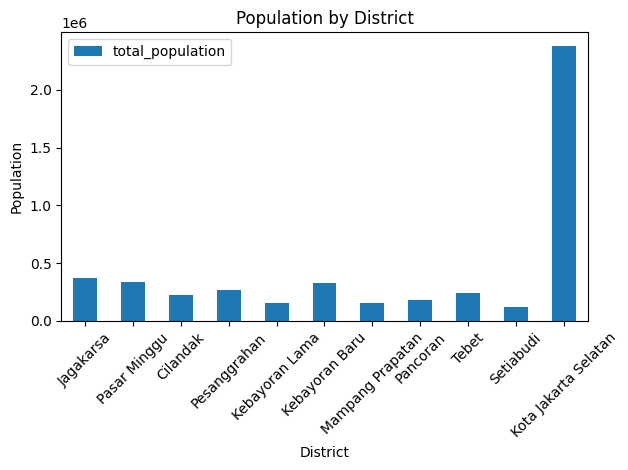

In [ ]:
# 📊 Visualisasi 1: Population by District
plt.figure(figsize=(10, 6))
df_analysis.plot(x='kecamatan', y='total_population', kind='bar')
plt.title('Population by District')
plt.xlabel('District')
plt.ylabel('Population')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

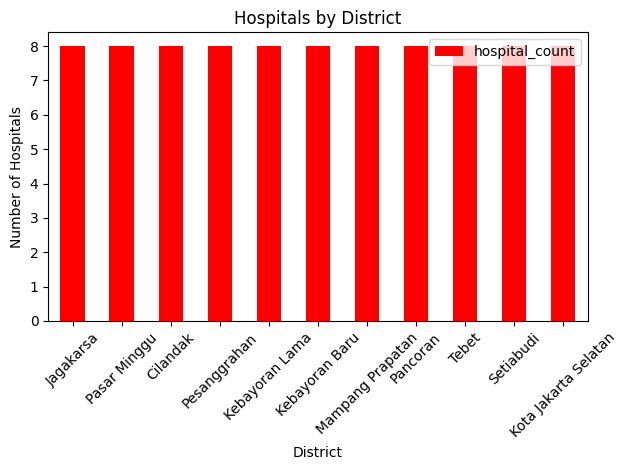

In [ ]:
# 📊 Visualisasi 2: Hospitals by District
plt.figure(figsize=(10, 6))
df_analysis.plot(x='kecamatan', y='hospital_count', kind='bar', color='red')
plt.title('Hospitals by District')
plt.xlabel('District')
plt.ylabel('Number of Hospitals')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

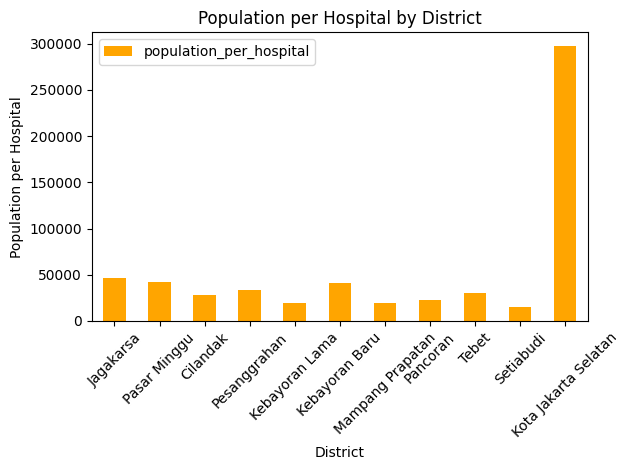

In [ ]:
# 📊 Visualisasi 3: Population per Hospital by District
plt.figure(figsize=(10, 6))
df_analysis.plot(x='kecamatan', y='population_per_hospital', kind='bar', color='orange')
plt.title('Population per Hospital by District')
plt.xlabel('District')
plt.ylabel('Population per Hospital')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

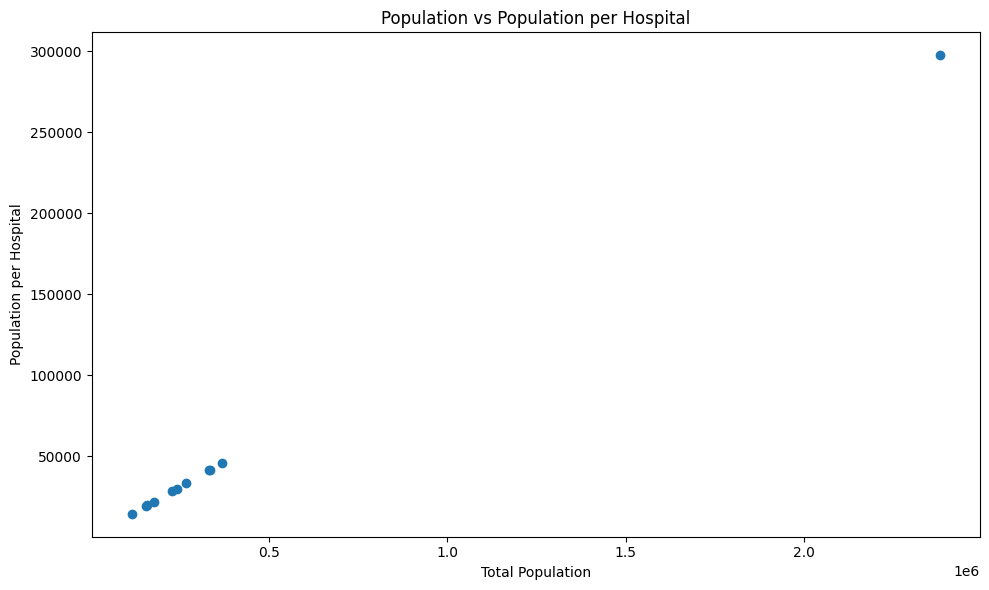

In [ ]:
# 📊 Visualisasi 4: Scatter Plot - Population vs Population per Hospital
plt.figure(figsize=(10, 6))
plt.scatter(df_analysis['total_population'], df_analysis['population_per_hospital'])
plt.title('Population vs Population per Hospital')
plt.xlabel('Total Population')
plt.ylabel('Population per Hospital')
plt.tight_layout()
plt.show()

In [ ]:
# 🗺️ Peta interaktif dengan integrasi data sosial ekonomi
# Create interactive map
m = folium.Map(location=[-6.33654, 106.81737], zoom_start=11)

# Add hospitals
for idx, row in hospital_points.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup="🏥 Rumah Sakit",
        icon=folium.Icon(color='red', icon='plus')
    ).add_to(m)

# Add road network (sample - reduced for performance)
sample_edges = edges.sample(min(1000, len(edges)))  # Sample untuk performa
folium.GeoJson(
    sample_edges,
    style_function=lambda x: {'color': 'blue', 'weight': 1, 'opacity': 0.7}
).add_to(m)

# Add district info (jika ada geometri)
if districts_gdf is not None:
    for idx, district in districts_gdf.iterrows():
        district_name = district['kecamatan']
        if district_name in df_analysis['kecamatan'].values:
            pop_data = df_analysis[df_analysis['kecamatan'] == district_name].iloc[0]

            folium.GeoJson(
                district.geometry,
                style_function=lambda x: {'fillColor': 'green', 'color': 'black', 'weight': 2, 'fillOpacity': 0.3},
                popup=folium.Popup(f"""
                <b>{district_name}</b><br>
                Population: {pop_data['total_population']:,}<br>
                Hospitals: {pop_data['hospital_count']}<br>
                Pop/Hospital: {pop_data['population_per_hospital']:,.0f}
                """, max_width=200)
            ).add_to(m)

# Add legend
legend_html = '''
<div style="position: fixed;
     top: 10px; right: 10px; width: 200px; height: 120px;
     background-color: white; border:2px solid grey; z-index:9999;
     font-size:14px; padding: 10px">
<b>Jakarta Selatan Analysis</b><br>
🔴 Hospitals<br>
🔵 Road Network<br>
🟢 District Boundaries<br>
<i>Population & Healthcare Access</i>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# Display map
print("✅ Interactive map created!")
m

✅ Interactive map created!


In [ ]:
# Save interactive map as HTML file
print("💾 Saving interactive map as HTML...")
map_filename = 'jakarta_selatan_interactive_map.html'
m.save(map_filename)

💾 Saving interactive map as HTML...


In [ ]:
# Download file in Google Colab
from google.colab import files
files.download(map_filename)
print(f"✅ Interactive map saved as {map_filename} and downloaded!")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✅ Interactive map saved as jakarta_selatan_interactive_map.html and downloaded!


📊 Creating distance distribution histogram...


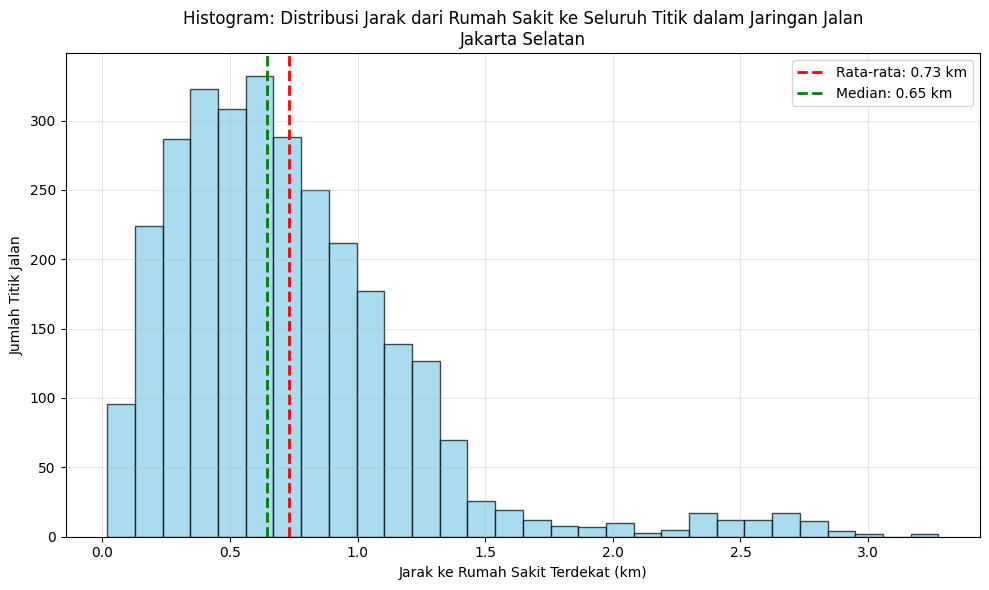


📈 Distribusi Jarak Rumah Sakit ke Jaringan Jalan:
   • Total titik dianalisis: 3,000
   • Rata-rata jarak: 0.73 km
   • Median jarak: 0.65 km
   • Jarak minimum: 0.02 km
   • Jarak maksimum: 3.28 km
✅ Histogram distribusi jarak selesai!


In [ ]:
# 📊 Histogram distribusi jarak dari rumah sakit ke seluruh titik dalam jaringan jalan
print("📊 Creating distance distribution histogram...")

if len(hospital_points) > 0:
    # Ambil koordinat rumah sakit
    hospital_coords = [[row.geometry.x, row.geometry.y] for idx, row in hospital_points.iterrows()]
    hospital_coords = np.array(hospital_coords)

    # Ambil sample koordinat node jalan (untuk performa)
    road_coords = []
    sample_nodes = list(G.nodes())[:3000]  # Sample 3000 node saja
    for node in sample_nodes:
        node_data = G.nodes[node]
        if 'x' in node_data and 'y' in node_data:
            road_coords.append([node_data['x'], node_data['y']])

    road_coords = np.array(road_coords)

    # Hitung jarak ke rumah sakit terdekat
    from scipy.spatial.distance import cdist
    distances_matrix = cdist(road_coords, hospital_coords, metric='euclidean')
    min_distances = np.min(distances_matrix, axis=1)

    # Konversi ke meter (1 derajat ≈ 111,320 meter)
    distances_meters = min_distances * 111320

    # Buat histogram
    plt.figure(figsize=(10, 6))
    plt.hist(distances_meters/1000, bins=30, alpha=0.7, color='skyblue', edgecolor='black')
    plt.xlabel('Jarak ke Rumah Sakit Terdekat (km)')
    plt.ylabel('Jumlah Titik Jalan')
    plt.title('Histogram: Distribusi Jarak dari Rumah Sakit ke Seluruh Titik dalam Jaringan Jalan\nJakarta Selatan')
    plt.grid(True, alpha=0.3)

    # Tambahkan garis statistik
    mean_dist = np.mean(distances_meters/1000)
    median_dist = np.median(distances_meters/1000)
    plt.axvline(mean_dist, color='red', linestyle='--', linewidth=2, label=f'Rata-rata: {mean_dist:.2f} km')
    plt.axvline(median_dist, color='green', linestyle='--', linewidth=2, label=f'Median: {median_dist:.2f} km')
    plt.legend()

    plt.tight_layout()
    plt.show()

    # Print statistik
    print(f"\n📈 Distribusi Jarak Rumah Sakit ke Jaringan Jalan:")
    print(f"   • Total titik dianalisis: {len(distances_meters):,}")
    print(f"   • Rata-rata jarak: {mean_dist:.2f} km")
    print(f"   • Median jarak: {median_dist:.2f} km")
    print(f"   • Jarak minimum: {np.min(distances_meters/1000):.2f} km")
    print(f"   • Jarak maksimum: {np.max(distances_meters/1000):.2f} km")

    print("✅ Histogram distribusi jarak selesai!")
else:
    print("⚠️ Tidak ada data rumah sakit untuk analisis jarak")

# **SUMMARY & INSIGHTS**

In [ ]:
# 📋 Summary dan Insights
print("📋 SUMMARY & INSIGHTS")
print("=" * 50)

print(f"🏙️ Jakarta Selatan Analysis Summary:")
print(f"   • Total Districts: {len(df_analysis)}")
print(f"   • Total Population: {df_analysis['total_population'].sum():,}")
print(f"   • Total Hospitals Found: {len(hospital_points)}")
print(f"   • Road Network Nodes: {len(G.nodes):,}")
print(f"   • Road Network Edges: {len(G.edges):,}")

print(f"\n🏥 Healthcare Accessibility:")
most_served = df_analysis.loc[df_analysis['population_per_hospital'].idxmin()]
least_served = df_analysis.loc[df_analysis['population_per_hospital'].idxmax()]

print(f"   • Best served district: {most_served['kecamatan']} ({most_served['population_per_hospital']:,.0f} people/hospital)")
print(f"   • Least served district: {least_served['kecamatan']} ({least_served['population_per_hospital']:,.0f} people/hospital)")
print(f"   • Average: {df_analysis['population_per_hospital'].mean():,.0f} people per hospital")

print(f"\n💡 Key Insights:")
print(f"   • District with highest population: {df_analysis.loc[df_analysis['total_population'].idxmax(), 'kecamatan']}")
print(f"   • Population density varies significantly across districts")
print(f"   • Healthcare accessibility needs improvement in some areas")

print("\n✅ Analysis completed successfully!")

📋 SUMMARY & INSIGHTS
🏙️ Jakarta Selatan Analysis Summary:
   • Total Districts: 11
   • Total Population: 4,759,366
   • Total Hospitals Found: 97
   • Road Network Nodes: 24,277
   • Road Network Edges: 53,632

🏥 Healthcare Accessibility:
   • Best served district: Setiabudi (14,632 people/hospital)
   • Least served district: Kota Jakarta Selatan (297,460 people/hospital)
   • Average: 54,084 people per hospital

💡 Key Insights:
   • District with highest population: Kota Jakarta Selatan
   • Population density varies significantly across districts
   • Healthcare accessibility needs improvement in some areas

✅ Analysis completed successfully!
